In [8]:
import pandas as pd
import numpy as np
import json

# Importing the data

In [9]:
train = []
with open('simplified-nq-train.jsonl', 'r') as file:
    print("Length of dataset", len(list(file)))
#     for i in range():
#         # read a sample of 2 json lines
#         train.append(json.loads(file.readline()))

Length of dataset 307373


In [10]:
train = []
with open('simplified-nq-train.jsonl', 'r') as file:
#     print("Length of dataset", len(list(file)))
    for i in range(1000):
        # read a sample of 2 json lines
        train.append(json.loads(file.readline()))

In [11]:
sample = train[0]
sample.keys()

dict_keys(['document_text', 'long_answer_candidates', 'question_text', 'annotations', 'document_url', 'example_id'])

In [12]:
sample['question_text']

'which is the most common use of opt-in e-mail marketing'

In [13]:
sample['document_text'][1952:2019]

'arketing is the act of sending a commercial message , typically to '

In [14]:
sample['annotations'][0]

{'yes_no_answer': 'NONE',
 'long_answer': {'start_token': 1952,
  'candidate_index': 54,
  'end_token': 2019},
 'short_answers': [{'start_token': 1960, 'end_token': 1969}],
 'annotation_id': 593165450220027640}

In [31]:
train[2]['annotations'][0]['short_answers']

[]

# Finding length of the answers

In [35]:
answerslen=[]
for i in train:
    if i['annotations'][0]['short_answers']!=[]:
        start=i['annotations'][0]['short_answers'][0]['start_token']
        end=i['annotations'][0]['short_answers'][0]['end_token']
        leng=end-start
        answerslen.append(leng)

In [36]:
answerslen[:10]

[9, 2, 2, 2, 19, 2, 25, 4, 4, 12]

In [37]:
answerslen.sort(reverse=True)
print('Length of the Top ten longest answers')
print(answerslen[0:10])

Length of the Top ten longest answers
[111, 48, 36, 33, 32, 31, 30, 25, 25, 25]


In [38]:
answerslenclean=[]
for i in answerslen:
    if i!=0:
        answerslenclean.append(i)

In [39]:
answerslenclean.sort()
print('Length of the Top ten shortest answers')
print(answerslenclean[:10])

Length of the Top ten shortest answers
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [40]:
print('Mean of the length of answers')
round(np.mean(answerslenclean),3)

Mean of the length of answers


4.784

In [41]:
print('Median of the length of answers')
round(np.median(answerslenclean),3)

Median of the length of answers


2.0

In [42]:
print('Percentile 75 of the length of answers')
round(np.percentile(answerslenclean,75),3)

Percentile 75 of the length of answers


4.0

In [43]:
print('Percentile 90 of the length of answers')
round(np.percentile(answerslenclean,90),3)

Percentile 90 of the length of answers


10.6

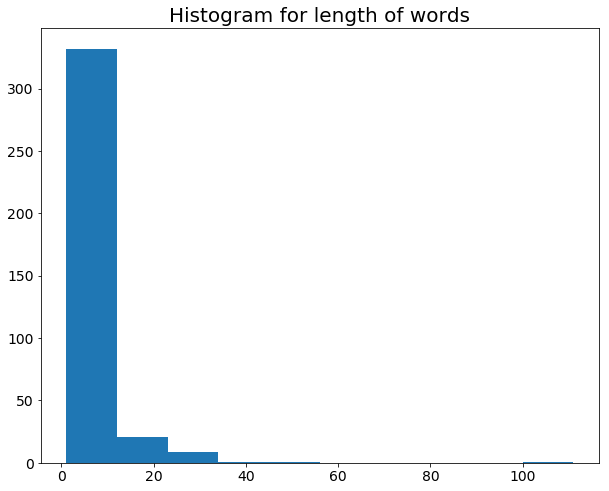

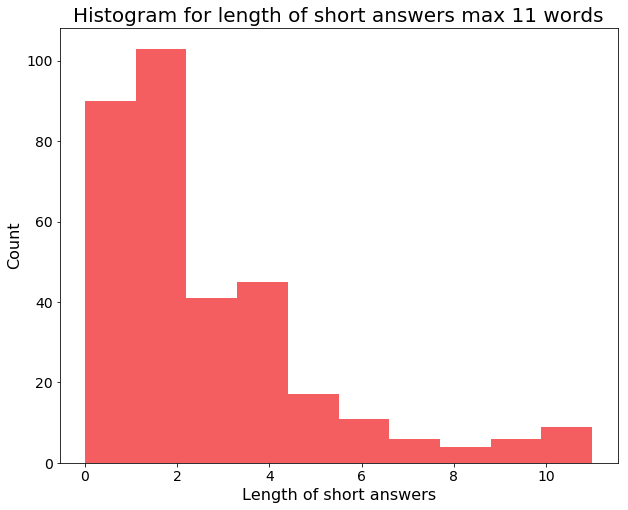

In [49]:
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (10,8)
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 16
plt.rcParams['xtick.labelsize']=14
plt.rcParams['ytick.labelsize']=14
plt.rcParams['legend.fontsize']=12

plt.hist(answerslenclean)
plt.title('Histogram for length of words')
plt.show()
# plt.hist(answerslenclean, range=(0,4000),color='#F55E61')
# plt.title('Histogram for length of words max length 4000')
# plt.show()
# plt.hist(answerslenclean, range=(0,2000),color='#F55E61')
# plt.title('Histogram for length of words max length 2000')
# plt.show()
plt.hist(answerslenclean, range=(0,11),color='#F55E61')
plt.title('Histogram for length of short answers max 11 words')
plt.xlabel('Length of short answers')
plt.ylabel('Count')
plt.show()

In [52]:
from collections import Counter
print( 'Number of answers by token length. For example, there are 21 answers of length 5')
Counter(answerslenclean)

Number of answers by token length. For example, there are 21 answers of length 5


Counter({5: 21,
         6: 184,
         7: 444,
         8: 257,
         9: 239,
         10: 250,
         11: 276,
         12: 236,
         13: 239,
         14: 219,
         15: 269,
         16: 236,
         17: 322,
         18: 278,
         19: 275,
         20: 326,
         21: 271,
         22: 274,
         23: 326,
         24: 365,
         25: 314,
         26: 343,
         27: 332,
         28: 386,
         29: 414,
         30: 398,
         31: 412,
         32: 434,
         33: 447,
         34: 429,
         35: 453,
         36: 436,
         37: 450,
         38: 513,
         39: 507,
         40: 522,
         41: 502,
         42: 596,
         43: 538,
         44: 631,
         45: 518,
         46: 579,
         47: 608,
         48: 676,
         49: 723,
         50: 715,
         51: 642,
         52: 660,
         53: 680,
         54: 743,
         55: 674,
         56: 730,
         57: 794,
         58: 805,
         59: 832,
         60: 832

# Finding type of questions

In [6]:
nlist = []
for i in range(len(train)):
    print(train[i]['question_text'])
    print((train[i]['question_text']).split(' ', 1)[0])
    nlist.append((train[i]['question_text']).split(' ', 1)[0])

which is the most common use of opt-in e-mail marketing
which
how i.met your mother who is the mother
how
what type of fertilisation takes place in humans
what
who had the most wins in the nfl
who
what happened to the lost settlement of roanoke
what
what are the different regions of africa and how do they differ
what
who played mantis guardians of the galaxy 2
who
who did the voice of the magician in frosty the snowman
who
what indian tribe did the acadians form friendships and alliances with
what
what is considered the outer banks in north carolina
what
who is deputy cm of j and k
who
bangko sentral ng pilipinas (central bank of the philippines)
bangko
actual time taken from start to finish to produce one unit of value
actual
i had trouble in getting to solla sellew
i
ed sheeran i ' m in love with your body
ed
the nashville sound brought a polished and cosmopolitan sound to country music by
the
the new atlantis a journal of technology and society
the
list the seven wonders of the mode

In [7]:
nlist

['which',
 'how',
 'what',
 'who',
 'what',
 'what',
 'who',
 'who',
 'what',
 'what',
 'who',
 'bangko',
 'actual',
 'i',
 'ed',
 'the',
 'the',
 'list',
 'rolling',
 'what',
 'what',
 'who',
 "god's",
 'who',
 'i',
 'the',
 'ru',
 'who',
 'why',
 'what',
 'when',
 'when',
 'what',
 'who',
 'when',
 'what',
 'is',
 'once',
 'where',
 'when',
 'who',
 'when',
 'where',
 'who',
 'how',
 'where',
 'when',
 'when',
 'where',
 'the',
 'who',
 'who',
 'who',
 'when',
 'into',
 "hitchhiker's",
 'name',
 "who's",
 'bridge',
 'who',
 'what',
 'is',
 'where',
 'i',
 'where',
 'who',
 'why',
 'how',
 'where',
 'where',
 'two',
 'difference',
 'who',
 'where',
 'what',
 'where',
 'purpose',
 'when',
 'who',
 'god',
 'who',
 'where',
 'when',
 'are',
 'what',
 'movement',
 'who',
 'city',
 'who',
 'what',
 'what',
 'who',
 'who',
 'where',
 'who',
 'the',
 'is',
 'who',
 'what',
 '1970',
 'who',
 'what',
 'how',
 'where',
 'the',
 'where',
 'what',
 'game',
 'what',
 'what',
 'where',
 'who',
 'wh

In [8]:
import seaborn as sns
sns.countplot(nlist)

In [9]:
wholist = []
for i in range(len(train)):
    if "who" in (train[i]['question_text']):
        print("Sucess")
        wholist.append(train[i])

Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess
Sucess

In [9]:
# import json

# with open('output.jsonl', 'w') as outfile:
#     for entry in wholist:
#         json.dump(entry, outfile)
#         outfile.write('\n')

In [10]:
# import_doc = []
# with open('output.jsonl', 'r') as file:
#     #print("Length of dataset", len(list(file)))
#     for i in range(4):
#         # read a sample of 2 json lines
#         import_doc.append(json.loads(file.readline()))

# Cleaning the Html tags

In [11]:
r = import_doc[0]['document_text']

In [12]:
import requests
from bs4 import BeautifulSoup

In [13]:
#declare a soup variable and read in the content
soup = BeautifulSoup(r, 'lxml')

In [14]:
print(soup)

<html><body><p>The Mother ( How I Met Your Mother ) - wikipedia </p><h1> The Mother ( How I Met Your Mother ) </h1> Jump to : navigation , search <table> <tr> <th_colspan> Tracy McConnell  </th_colspan></tr> <tr> <td_colspan> How I Met Your Mother character  </td_colspan></tr> <tr> <td_colspan> The Mother appearing in `` The Locket ''  </td_colspan></tr> <tr> <th> First appearance </th> <td> `` Lucky Penny ( unseen ) '' `` Something New '' ( seen ) </td> </tr> <tr> <th> Last appearance </th> <td> `` Last Forever '' </td> </tr> <tr> <th> Created by </th> <td> Carter Bays Craig Thomas </td> </tr> <tr> <th> Portrayed by </th> <td> Cristin Milioti </td> </tr> <tr> <th_colspan> Information  </th_colspan></tr> <tr> <th> Aliases </th> <td> The Mother </td> </tr> <tr> <th> Gender </th> <td> Female </td> </tr> <tr> <th> Spouse ( s ) </th> <td> Ted Mosby </td> </tr> <tr> <th> Significant other ( s ) </th> <td> Max ( deceased former boyfriend ) Louis ( ex-boyfriend ) </td> </tr> <tr> <th> Childre

In [15]:
#prettify the results
print(soup.prettify())

<html>
 <body>
  <p>
   The Mother ( How I Met Your Mother ) - wikipedia
  </p>
  <h1>
   The Mother ( How I Met Your Mother )
  </h1>
  Jump to : navigation , search
  <table>
   <tr>
    <th_colspan>
     Tracy McConnell
    </th_colspan>
   </tr>
   <tr>
    <td_colspan>
     How I Met Your Mother character
    </td_colspan>
   </tr>
   <tr>
    <td_colspan>
     The Mother appearing in `` The Locket ''
    </td_colspan>
   </tr>
   <tr>
    <th>
     First appearance
    </th>
    <td>
     `` Lucky Penny ( unseen ) '' `` Something New '' ( seen )
    </td>
   </tr>
   <tr>
    <th>
     Last appearance
    </th>
    <td>
     `` Last Forever ''
    </td>
   </tr>
   <tr>
    <th>
     Created by
    </th>
    <td>
     Carter Bays Craig Thomas
    </td>
   </tr>
   <tr>
    <th>
     Portrayed by
    </th>
    <td>
     Cristin Milioti
    </td>
   </tr>
   <tr>
    <th_colspan>
     Information
    </th_colspan>
   </tr>
   <tr>
    <th>
     Aliases
    </th>
    <td>
     The M